## **Connecting colab with kaggle using kaggle API**

In [1]:
#install kaggle
!pip install -q kaggle

In [2]:
#upload the kaggle.json file
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"learn2know","key":"ef7c1f3683ce0590f0cee38b88d74d21"}'}

In [3]:
#create a kaggle directory
!mkdir ~/.kaggle

In [4]:
#copy the kaggle.json to kaggle directory
!cp kaggle.json ~/.kaggle/

In [5]:
#permission for the json to act
!chmod 600 ~/.kaggle/kaggle.json

In [6]:
#list all the available dataset in kaggle
!kaggle datasets list

ref                                                                   title                                                size  lastUpdated          downloadCount  voteCount  usabilityRating  
--------------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
muratkokludataset/date-fruit-datasets                                 Date Fruit Datasets                                 408KB  2022-04-03 09:25:39           8465       1139  0.9375           
victorsoeiro/netflix-tv-shows-and-movies                              Netflix TV Shows and Movies                           2MB  2022-05-15 00:01:23            889         38  0.9411765        
mdmahmudulhasansuzan/students-adaptability-level-in-online-education  Students Adaptability Level in Online Education       6KB  2022-04-16 04:46:28           5645        143  1.0              
muratkokludataset/rice-image-d

## **Get g-research-crypto-forecasting dataset**

In [7]:
!kaggle competitions download -c g-research-crypto-forecasting

 99% 1.12G/1.13G [00:15<00:00, 79.0MB/s]
100% 1.13G/1.13G [00:15<00:00, 79.8MB/s]


In [8]:
#unzip the target file
!unzip g-research-crypto-forecasting.zip

Archive:  g-research-crypto-forecasting.zip
  inflating: asset_details.csv       
  inflating: example_sample_submission.csv  
  inflating: example_test.csv        
  inflating: gresearch_crypto/__init__.py  
  inflating: gresearch_crypto/competition.cpython-37m-x86_64-linux-gnu.so  
  inflating: supplemental_train.csv  
  inflating: train.csv               


## **EDA: Exploratory Data Analysis**

In [2]:
#import libraries
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
plt.style.use("fivethirtyeight")
%matplotlib inline

# For reading stock data from yahoo
from pandas_datareader.data import DataReader
   
# For time stamps
from datetime import datetime
from math import sqrt
from math import sqrt
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler

#ignore the warnings
import warnings
warnings.filterwarnings('ignore')

In [3]:
data_folder = "../content/"
crypto_df = pd.read_csv(data_folder + 'train.csv')

crypto_df.head(10)

,timestamp,Asset_ID,Count,Open,High,Low,Close,Volume,VWAP,Target
0,1514764860,2,40.0,2376.580000,2399.5000,2357.1400,2374.590000,19.233005,2373.116392,-0.004218
1,1514764860,0,5.0,8.530000,8.5300,8.5300,8.530000,78.380000,8.530000,-0.014399
2,1514764860,1,229.0,13835.194000,14013.8000,13666.1100,13850.176000,31.550062,13827.062093,-0.014643
3,1514764860,5,32.0,7.659600,7.6596,7.6567,7.657600,6626.713370,7.657713,-0.013922
4,1514764860,7,5.0,25.920000,25.9200,25.8740,25.877000,121.087310,25.891363,-0.008264
5,1514764860,6,173.0,738.302500,746.0000,732.5100,738.507500,335.987856,738.839291,-0.004809
6,1514764860,9,167.0,225.330000,227.7800,222.9800,225.206667,411.896642,225.197944,-0.009791
7,1514764860,11,7.0,329.090000,329.8800,329.0900,329.460000,6.635710,329.454118,NaN
8,1514764920,2,53.0,2374.553333,2400.9000,2354.2000,2372.286667,24.050259,2371.434498,-0.004079
9,1514764920,0,7.0,8.530000,8.5300,8.5145,8.514500,71.390000,8.520215,-0.015875


**Data features**

In [4]:
import seaborn as sns
#cm = sns.light_palette("viridis", as_cmap=True)

asset_details = pd.read_csv(data_folder + 'asset_details.csv')
#asset_details.style.bar()
asset_details.style.background_gradient(cmap='gist_rainbow_r')

,Asset_ID,Weight,Asset_Name
0,2,2.397895,Bitcoin Cash
1,0,4.304065,Binance Coin
2,1,6.779922,Bitcoin
3,5,1.386294,EOS.IO
4,7,2.079442,Ethereum Classic
5,6,5.894403,Ethereum
6,9,2.397895,Litecoin
7,11,1.609438,Monero
8,13,1.791759,TRON
9,12,2.079442,Stellar


In [5]:
crypto_df['timestamp'] = pd.to_datetime(crypto_df['timestamp'], unit='s')
crypto_df.rename({'timestamp': 'Date'}, axis=1, inplace=True)

In [6]:
def crypto_df_subset(asset_id ,data):
    df = data[data["Asset_ID"]==asset_id] #.set_index("Date")
    return df

In [7]:
import random 

def plot_close_val(data_frame, column, stock):
    sns.set_style('whitegrid')
    plt.style.use("fivethirtyeight")
    plt.figure(figsize=(16,6))
    plt.title(column + ' Price History for ' + stock )
    plt.plot(data_frame[column],color="#"+''.join([random.choice('ABCDEF0123456789') for i in range(6)]))
    plt.xlabel('Date')#, fontsize=18)
    plt.ylabel(column + ' for ' + stock )#, fontsize=18)
    plt.show()

In [8]:
try:
    import mplfinance as mpf
except:
    !pip -q install mplfinance
    import mplfinance as mpf

In [9]:
def mplplot(data_frame, stock):
    titletext =  stock + 'MPL Finance OHLC Plot'
    mpf.plot(data_frame,type='candle',volume=True, mav=(7,14,28),figratio=(5,2), style='charles',title= titletext)

In [10]:
crypto_df['Date'] = pd.to_datetime(crypto_df.Date, utc=False)

In [11]:
crypto_df.head()
def time_series_features(df, dt_col='Date', label=None):
    """
    Creates time series features from datetime index.
    """
    df = df.copy()
    df['hour'] = df[dt_col].dt.hour
    df['dayofweek'] = df[dt_col].dt.dayofweek
    df['quarter'] = df[dt_col].dt.quarter
    df['month'] = df[dt_col].dt.month
    df['year'] = df[dt_col].dt.year
    df['dayofyear'] = df[dt_col].dt.dayofyear
    df['dayofmonth'] = df[dt_col].dt.day
    df['weekofyear'] = df[dt_col].dt.isocalendar().week
    return df

crypto_df = time_series_features(crypto_df)

In [12]:
def sn_pairplot(subsett):
    ax = sns.pairplot(subsett,
                      hue='year',
                      vars=['Volume',
                            'Count',
                            'VWAP',
                            'Target',
                           ])

In [13]:
#Let us try a simple Plotly OHLC plot for the assets
# code inspired by from @yamqwe
import gc
pd.set_option("display.max_columns", None)
from datetime import datetime
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 14})
data_folder = "../content/"
asst_det = pd.read_csv(data_folder + 'asset_details.csv', low_memory=False)
#train = pd.read_csv(data_folder + 'train.csv', low_memory=False)
rename_dict = {}
for a in asst_det['Asset_ID']: rename_dict[a] = asst_det[asst_det.Asset_ID == a].Asset_Name.values[0]
crypto_df['Date'] = crypto_df['Date'].astype('datetime64[s]')
train_daily = pd.DataFrame()

In [14]:
# code inspired by from @yamqwe

for asset_id in asst_det.Asset_ID:
    train_single = crypto_df[crypto_df.Asset_ID == asset_id].copy()
    train_single_new = train_single[['Date','Count']].resample('D', on='Date').sum()
    train_single_new['Open'] = train_single[['Date','Open']].resample('D', on='Date').first()['Open']
    train_single_new['High'] = train_single[['Date','High']].resample('D', on='Date').max()['High']
    train_single_new['Low'] = train_single[['Date','Low']].resample('D', on='Date').min()['Low']
    train_single_new['Close'] = train_single[['Date','Close']].resample('D', on='Date').last()['Close']
    train_single_new['Volume'] = train_single[['Date','Volume']].resample('D', on='Date').sum()['Volume']
    train_single_new['Asset_ID'] = asset_id
    train_daily = train_daily.append(train_single_new.reset_index(drop=False))
train_daily = train_daily.sort_values(by = ['Date', 'Asset_ID']).reset_index(drop=True)
train_daily = train_daily.pivot(index='Date', columns='Asset_ID')[['Count', 'Open', 'High', 'Low', 'Close', 'Volume']]
train_daily = train_daily.reset_index(drop=False)
train_daily['year'] = pd.DatetimeIndex(train_daily['Date']).year
fig = make_subplots( rows=len(asst_det.Asset_ID), cols=1, subplot_titles=(asst_det.Asset_Name) )
for i, asset_id in enumerate(asst_det.Asset_ID):
    fig.append_trace(go.Candlestick(x=train_daily.Date, 
                                    name=asst_det.Asset_Name[i], 
                                    open=train_daily[('Open', asset_id)], 
                                    high=train_daily[('High', asset_id)], 
                                    low=train_daily[('Low', asset_id)], 
                                    close=train_daily[('Close', asset_id)]),
                     row=i+1, col=1)
    fig.update_xaxes(range=[train_daily.Date.iloc[0], train_daily.Date.iloc[-1]], row=i+1, col=1)
    fig.update_traces(increasing_fill_color='#fa0388', selector=dict(type='ohlc'))
    fig.update_traces(increasing_line_color='#fc0388', selector=dict(type='ohlc'))
    fig.update_traces(decreasing_fill_color='#fae703', selector=dict(type='ohlc'))
    fig.update_traces(decreasing_line_color='#fce703', selector=dict(type='ohlc'))
    #fig.show()

fig.update_layout(xaxis_rangeslider_visible = False, 
                  xaxis2_rangeslider_visible = False, 
                  xaxis3_rangeslider_visible = False,
                  xaxis4_rangeslider_visible = False,
                  xaxis5_rangeslider_visible = False,
                  xaxis6_rangeslider_visible = False,
                  xaxis7_rangeslider_visible = False,
                  xaxis8_rangeslider_visible = False,
                  xaxis9_rangeslider_visible = False,
                  xaxis10_rangeslider_visible = False,
                  xaxis11_rangeslider_visible = False,
                  xaxis12_rangeslider_visible = False,
                  xaxis13_rangeslider_visible = False,
                  xaxis14_rangeslider_visible = False,
                  height=6000, width=1200, 
                  title_text="Plotly OHLC Plots for all G-Research Crypto Assets",
                  #legendgrouptitle_font_color='purple',
                  #legendgrouptitle_font_size=30,
                  #legendgrouptitle_font_family='Raleway',
                  #legendgrouptitle="Plotly OHLC Plots for all G-Research Crypto Assets",
                      margin = dict(
                          l = 5,
                          r = 5,
                          b = 5,
                          t = 30,
                          pad = 5)
                 )    
fig.update_traces(increasing_fill_color='#fa0388', selector=dict(type='ohlc'))
fig.update_traces(increasing_line_color='#fc0388', selector=dict(type='ohlc'))
fig.update_traces(decreasing_fill_color='#fae703', selector=dict(type='ohlc'))
fig.update_traces(decreasing_line_color='#fce703', selector=dict(type='ohlc'))
fig.update_traces(legendgrouptitle_font_size=30, selector=dict(type='ohlc'))
fig.update_traces(legendgrouptitle_font_family='Raleway', selector=dict(type='ohlc'))
fig.update_traces(legendgrouptitle="Plotly OHLC Plots for all G-Research Crypto Assets", selector=dict(type='ohlc'))
fig.update_traces(legendgrouptitle_font_color='purple', selector=dict(type='ohlc'))
fig.show()

del train_daily,train_single, asst_det
gc.collect()
plt.close()

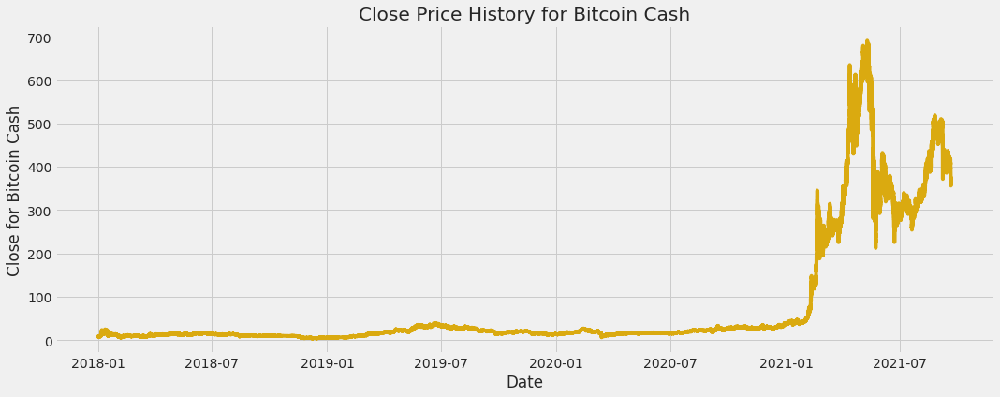

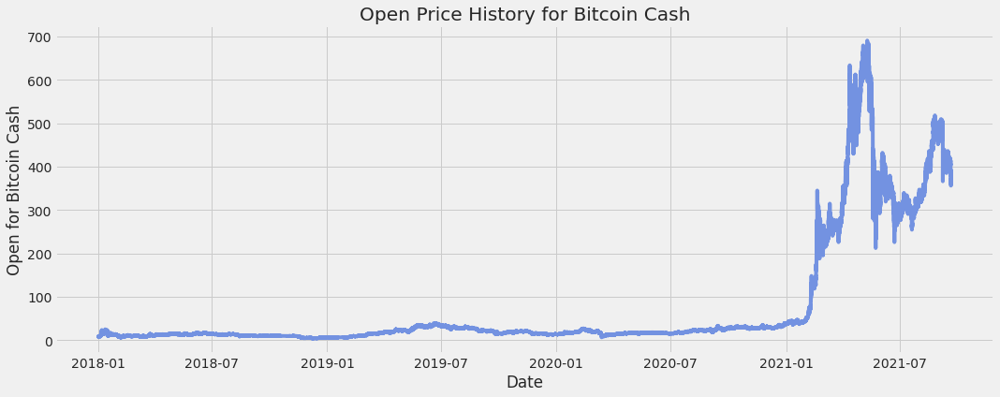

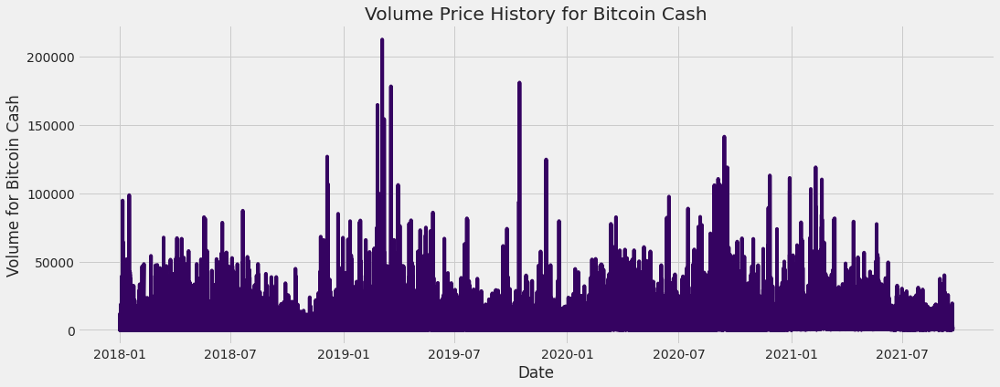

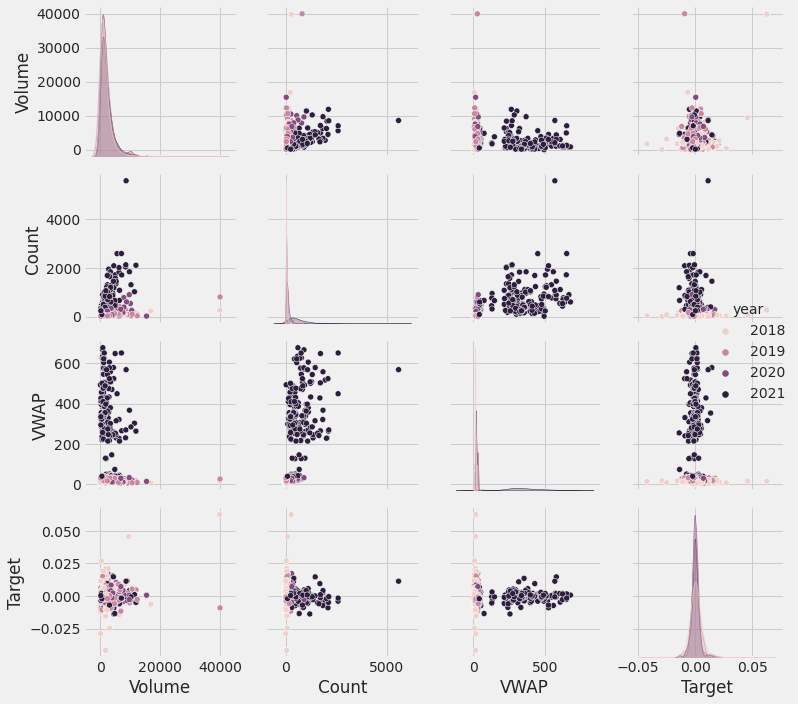

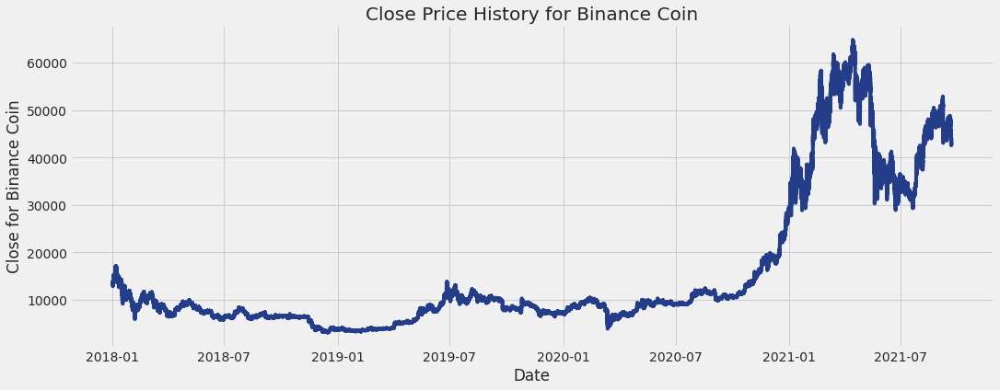

...

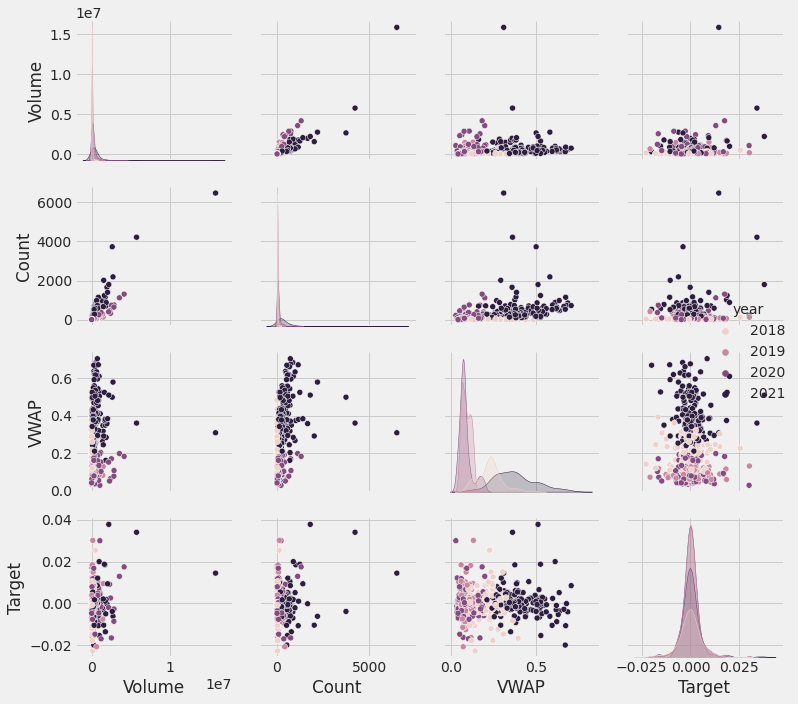

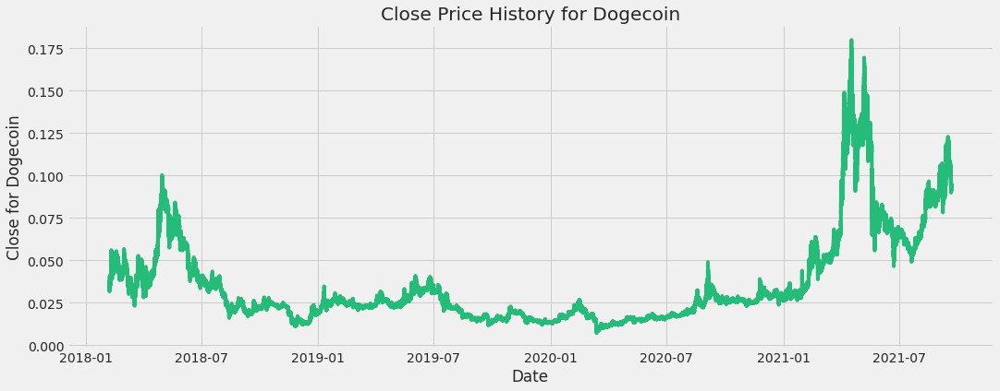

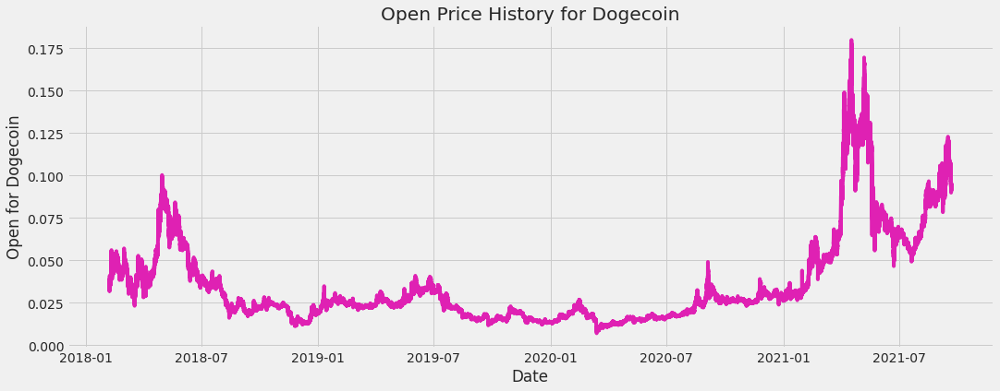

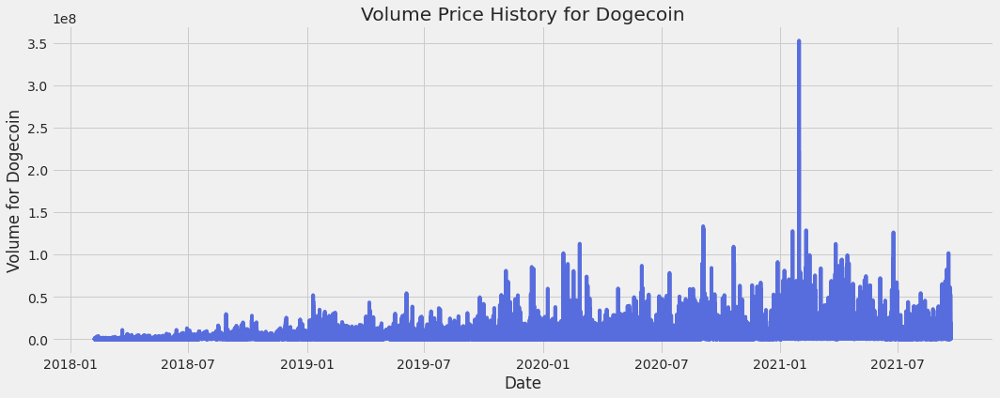

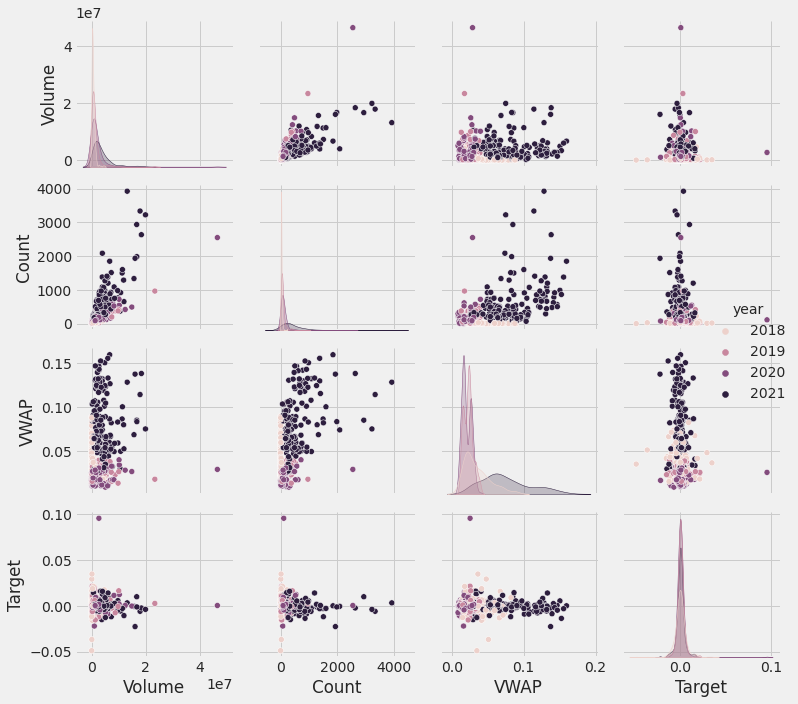

In [15]:
from matplotlib import gridspec, ticker
asset_names = asset_details.Asset_Name.unique()
for i in range(0,14):
    subsett = crypto_df_subset(i, crypto_df)
    subsett['Date'] = pd.to_datetime(subsett.Date, utc=False)
    subsett.index = pd.DatetimeIndex(subsett['Date'])
    plot_close_val(subsett, 'Close',asset_names[i])
    plot_close_val(subsett, 'Open',asset_names[i])
    plot_close_val(subsett, 'Volume',asset_names[i])
    # Try an MPLPlot for the 4000-5000 Data point range
#    mplplot(subsett[4000:5000], asset_names[i])
    subsett=subsett.sample(1_000, random_state=529)
    sn_pairplot(subsett)      
    plt.tight_layout()
    plt.show()
    del subsett

In [16]:
#Basic Asset Info
asset_count= []
for i in range(14):
    count = (crypto_df["Asset_ID"]==i).sum()
    asset_count.append(count)

In [17]:
asset_map = asset_details.set_index('Asset_ID')['Asset_Name'].to_dict()
crypto_df['Asset_Name'] = crypto_df['Asset_ID'].map(asset_map)
crypto_df.head()
print(asset_details)
print(asset_map)

    Asset_ID    Weight        Asset_Name
0          2  2.397895      Bitcoin Cash
1          0  4.304065      Binance Coin
2          1  6.779922           Bitcoin
3          5  1.386294            EOS.IO
4          7  2.079442  Ethereum Classic
5          6  5.894403          Ethereum
6          9  2.397895          Litecoin
7         11  1.609438            Monero
8         13  1.791759              TRON
9         12  2.079442           Stellar
10         3  4.406719           Cardano
11         8  1.098612              IOTA
12        10  1.098612             Maker
13         4  3.555348          Dogecoin
{2: 'Bitcoin Cash', 0: 'Binance Coin', 1: 'Bitcoin', 5: 'EOS.IO', 7: 'Ethereum Classic', 6: 'Ethereum', 9: 'Litecoin', 11: 'Monero', 13: 'TRON', 12: 'Stellar', 3: 'Cardano', 8: 'IOTA', 10: 'Maker', 4: 'Dogecoin'}


In [18]:
import plotly.express as px
import plotly.graph_objects as go

fig = px.bar(y = asset_details.sort_values("Asset_ID")["Asset_Name"],
             x = asset_count , 
             color = asset_count ,
             color_continuous_scale="Spectral") 
fig.update_yaxes(title="Assets")
fig.update_xaxes(title = "Number of Entries")
fig.update_layout(showlegend = True,
    title = {
        'text': 'Asset Data Distribution ',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [19]:
asset_details["Weight_Percentage"] = (asset_details["Weight"] / asset_details["Weight"].sum()) * 100
asset_details.sort_values("Weight", ascending=False).style.background_gradient(cmap='gist_rainbow_r')

,Asset_ID,Weight,Asset_Name,Weight_Percentage
2,1,6.779922,Bitcoin,16.584998
5,6,5.894403,Ethereum,14.418848
10,3,4.406719,Cardano,10.779686
1,0,4.304065,Binance Coin,10.528574
13,4,3.555348,Dogecoin,8.697068
0,2,2.397895,Bitcoin Cash,5.865715
6,9,2.397895,Litecoin,5.865715
4,7,2.079442,Ethereum Classic,5.086716
9,12,2.079442,Stellar,5.086716
8,13,1.791759,TRON,4.382990


In [20]:
fig = px.pie(asset_details, values='Weight_Percentage', names='Asset_Name', title='Cryptocurrency Asset Weightage')
fig.show()

In [21]:
fig = px.sunburst(data_frame=asset_details,
                  path=['Asset_Name','Weight_Percentage', 'Weight'],
                  color='Asset_Name',
                  color_discrete_sequence=px.colors.qualitative.Alphabet,
                  title='Asset_ID'
                 )

fig.update_traces(textinfo='label')
fig.update_layout(margin=dict(t=40, l=0, r=0, b=0))
fig.show()

In [22]:
btc = crypto_df_subset(0, crypto_df)
#subset last 10000 rows
btc=btc[-10000:]
btc.shape
btc['Date']=btc['Date'].astype('datetime64[s]')

**Some VWAP Violin Chart for Crypto Assets**

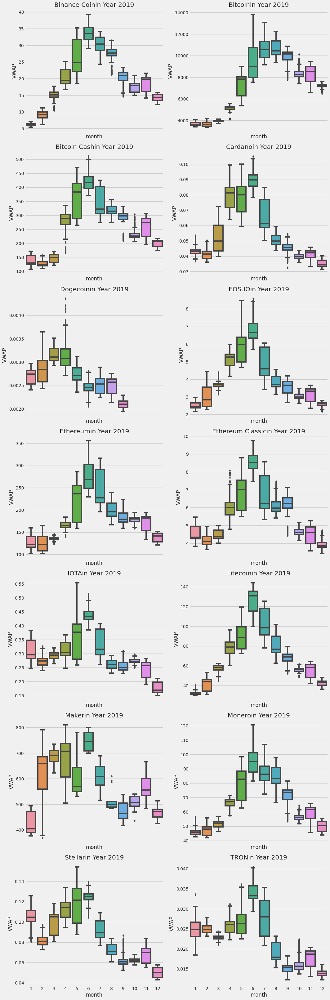

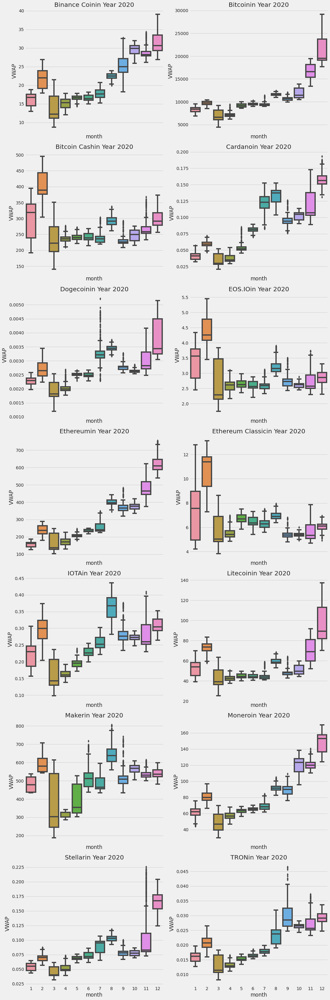

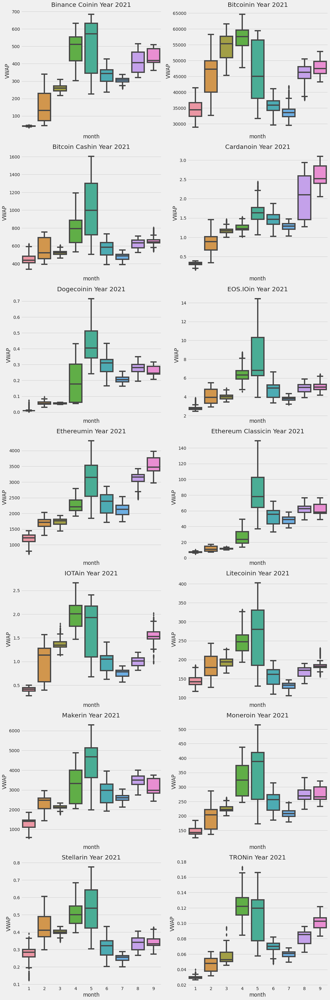

In [23]:
#VWAP Plot 2019
fig, axs = plt.subplots(7, 2,
                        figsize=(15, 45), sharex=True)
axs = axs.flatten()
i = 0
for asn, d in crypto_df.query('year == 2019').sample(1_000_00, random_state=529).groupby('Asset_Name'):
    sns.boxplot(data=d, x='month', y='VWAP', ax=axs[i])
    axs[i].set_title(asn + 'in Year 2019')
    i += 1
plt.tight_layout()
plt.show()

#VWAP Plot 2020
fig, axs = plt.subplots(7, 2,
                        figsize=(15, 45), sharex=True)
axs = axs.flatten()
i = 0
for asn, d in crypto_df.query('year == 2020').sample(1_000_00, random_state=529).groupby('Asset_Name'):
    sns.boxplot(data=d, x='month', y='VWAP', ax=axs[i])
    axs[i].set_title(asn + 'in Year 2020')
    i += 1
plt.tight_layout()
plt.show()

#VWAP Plot 2020
fig, axs = plt.subplots(7, 2,
                        figsize=(15, 45), sharex=True)
axs = axs.flatten()
i = 0
for asn, d in crypto_df.query('year == 2021').sample(1_000_00, random_state=529).groupby('Asset_Name'):
    sns.boxplot(data=d, x='month', y='VWAP', ax=axs[i])
    axs[i].set_title(asn + 'in Year 2021')
    i += 1
plt.tight_layout()
plt.show()

In [24]:
#Basic Rolling Averages
# Isolate the adjusted closing prices 
adj_close_px = btc['Close']

# Calculate the moving average
moving_avg = adj_close_px.rolling(window=40).mean()

# Inspect the result
moving_avg[-10:]

24236668    361.051537
24236682    361.112425
24236696    361.196262
24236710    361.234163
24236724    361.306187
24236738    361.319163
24236752    361.337713
24236766    361.322725
24236780    361.388100
24236794    361.455787
Name: Close, dtype: float64

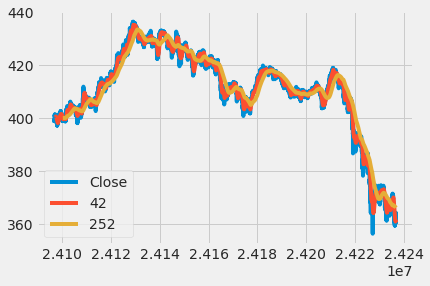

In [25]:
# Short moving window rolling mean
btc['42'] = adj_close_px.rolling(window=40).mean()

# Long moving window rolling mean
btc['252'] = adj_close_px.rolling(window=252).mean()

# Plot the adjusted closing price, the short and long windows of rolling means
btc[['Close', '42', '252']].plot()

plt.show()

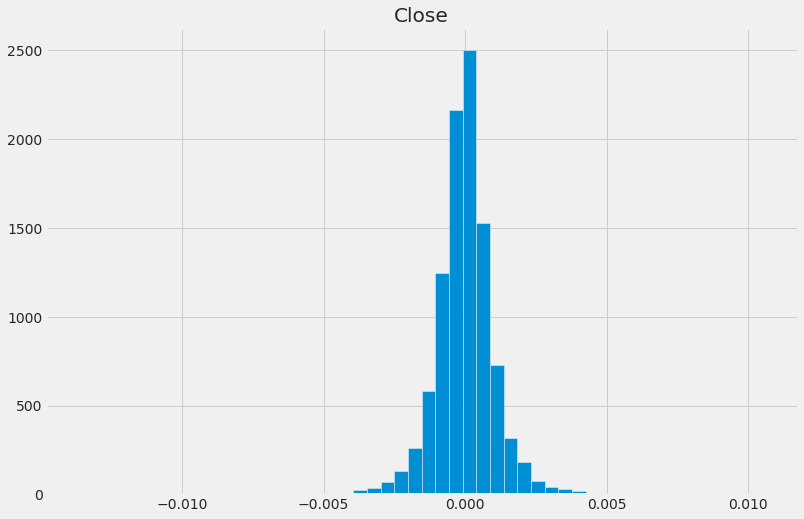

In [26]:
daily_close_px = btc[['Close']]
# Calculate the daily percentage change for `daily_close_px`
daily_pct_change = daily_close_px.pct_change()

# Plot the distributions
daily_pct_change.hist(bins=50, sharex=True, figsize=(12,8))

# Show the resulting plot
plt.show()

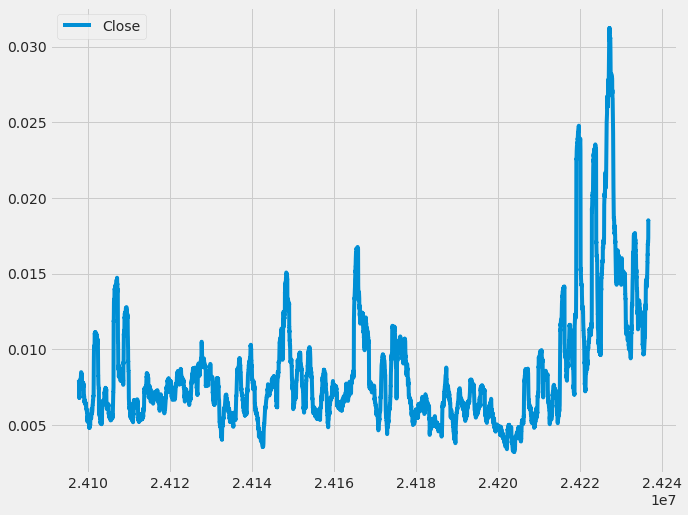

In [27]:
# Define the minumum of periods to consider 
min_periods = 75 

# Calculate the volatility
vol = daily_pct_change.rolling(min_periods).std() * np.sqrt(min_periods) 

# Plot the volatility
vol.plot(figsize=(10, 8))

# Show the plot
plt.show()

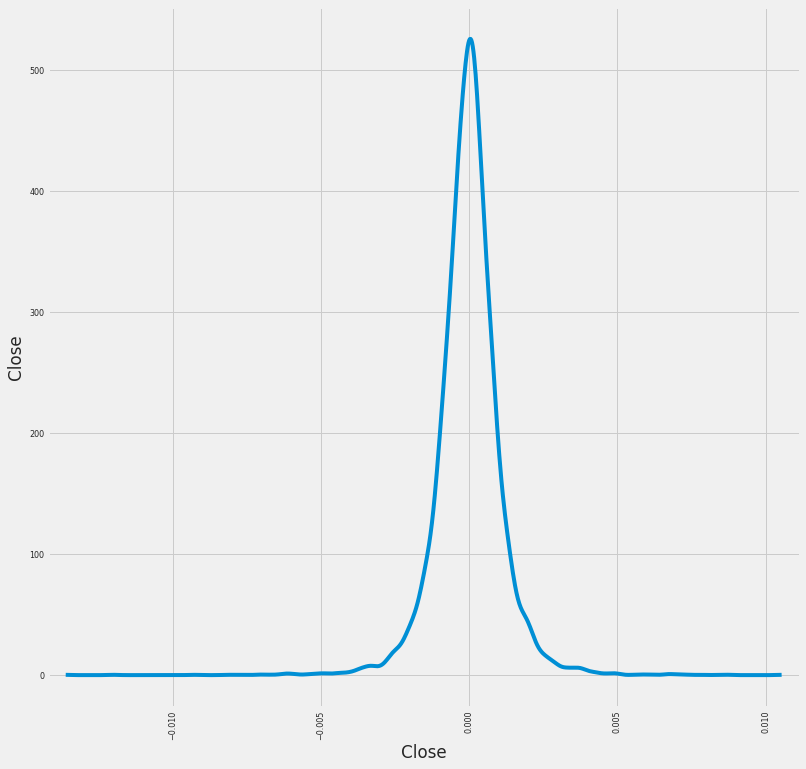

In [28]:
# Plot a scatter matrix with the `daily_pct_change` data 
pd.plotting.scatter_matrix(daily_pct_change, diagonal='kde', alpha=0.1,figsize=(12,12))

# Show the plot
plt.show()

In [29]:
#Basic MACD
import plotly.graph_objects as go

btc=btc.reset_index()

fig = go.Figure(data=go.Ohlc(x=btc['Date'],
        open=btc['Open'],
        high=btc['High'],
        low=btc['Low'],
        close=btc['Close']))
fig.show()

In [30]:
btc=btc.reset_index()

btc['SMA5'] = btc.Close.rolling(5).mean()
btc['SMA20'] = btc.Close.rolling(20).mean()
btc['SMA50'] = btc.Close.rolling(50).mean()
btc['SMA200'] = btc.Close.rolling(200).mean()
btc['SMA500'] = btc.Close.rolling(500).mean()

fig = go.Figure(data=[go.Ohlc(x=btc['Date'],open=btc['Open'],high=btc['High'],low=btc['Low'],close=btc['Close'], name = "OHLC"),
                      go.Scatter(x=btc.Date, y=btc.SMA5, line=dict(color='orange', width=1), name="SMA5"),
                      go.Scatter(x=btc.Date, y=btc.SMA20, line=dict(color='green', width=1), name="SMA20"),
                      go.Scatter(x=btc.Date, y=btc.SMA50, line=dict(color='blue', width=1), name="SMA50"),
                      go.Scatter(x=btc.Date, y=btc.SMA200, line=dict(color='violet', width=1), name="SMA200"),
                      go.Scatter(x=btc.Date, y=btc.SMA500, line=dict(color='purple', width=1), name="SMA500")])
fig.show()

In [31]:
btc['EMA5'] = btc.Close.ewm(span=5, adjust=False).mean()
btc['EMA20'] = btc.Close.ewm(span=20, adjust=False).mean()
btc['EMA50'] = btc.Close.ewm(span=50, adjust=False).mean()
btc['EMA200'] = btc.Close.ewm(span=200, adjust=False).mean()
btc['EMA500'] = btc.Close.ewm(span=500, adjust=False).mean()

fig = go.Figure(data=[go.Ohlc(x=btc['Date'],
                              open=btc['Open'],
                              high=btc['High'],
                              low=btc['Low'],
                              close=btc['Close'], name = "OHLC"),
                      go.Scatter(x=btc.Date, y=btc.SMA5, line=dict(color='orange', width=1), name="EMA5"),
                      go.Scatter(x=btc.Date, y=btc.SMA20, line=dict(color='green', width=1), name="EMA20"),
                      go.Scatter(x=btc.Date, y=btc.SMA50, line=dict(color='blue', width=1), name="EMA50"),
                      go.Scatter(x=btc.Date, y=btc.SMA200, line=dict(color='violet', width=1), name="EMA200"),
                      go.Scatter(x=btc.Date, y=btc.SMA500, line=dict(color='purple', width=1), name="EMA500")])
fig.show()

**FINTA Tech Analysis Ratios**

Simple Moving Average 'SMA'

Simple Moving Median 'SMM'

Smoothed Simple Moving Average 'SSMA'

Exponential Moving Average 'EMA'

Double Exponential Moving Average 'DEMA'

Triple Exponential Moving Average 'TEMA'

Triangular Moving Average 'TRIMA'

Triple Exponential Moving Average Oscillator 'TRIX'

Volume Adjusted Moving Average 'VAMA'

Kaufman Efficiency Indicator 'ER'

Kaufman's Adaptive Moving Average 'KAMA'

Zero Lag Exponential Moving Average 'ZLEMA'

Weighted Moving Average 'WMA'

Hull Moving Average 'HMA'

Elastic Volume Moving Average 'EVWMA'

Volume Weighted Average Price 'VWAP'

Smoothed Moving Average 'SMMA'

Fractal Adaptive Moving Average 'FRAMA'

Moving Average Convergence Divergence 'MACD'

Percentage Price Oscillator 'PPO'

Volume-Weighted MACD 'VW_MACD'

Elastic-Volume weighted MACD 'EV_MACD'

Market Momentum 'MOM'

Rate-of-Change 'ROC'

Relative Strenght Index 'RSI'

Inverse Fisher Transform RSI 'IFT_RSI'

True Range 'TR'

Average True Range 'ATR'

Stop-and-Reverse 'SAR'

Bollinger Bands 'BBANDS'

Bollinger Bands Width 'BBWIDTH'

Momentum Breakout Bands 'MOBO'

Percent B 'PERCENT_B'

Keltner Channels 'KC'

Donchian Channel 'DO'

Directional Movement Indicator 'DMI'

Average Directional Index 'ADX'

Pivot Points 'PIVOT'

Fibonacci Pivot Points 'PIVOT_FIB'

Stochastic Oscillator %K 'STOCH'

Stochastic oscillator %D 'STOCHD'

Stochastic RSI 'STOCHRSI'

Williams %R 'WILLIAMS'

Ultimate Oscillator 'UO'

Awesome Oscillator 'AO'

Mass Index 'MI'

Vortex Indicator 'VORTEX'

Know Sure Thing 'KST'

True Strength Index 'TSI'

Typical Price 'TP'

Accumulation-Distribution Line 'ADL'

Chaikin Oscillator 'CHAIKIN'

Money Flow Index 'MFI'

On Balance Volume 'OBV'

Weighter OBV 'WOBV'

Volume Zone Oscillator 'VZO'

Price Zone Oscillator 'PZO'

Elder's Force Index 'EFI'

Cummulative Force Index 'CFI'

Bull power and Bear Power 'EBBP'

Ease of Movement 'EMV'

Commodity Channel Index 'CCI'

Coppock Curve 'COPP'

Buy and Sell Pressure 'BASP'

Normalized BASP 'BASPN'

Chande Momentum Oscillator 'CMO'

Chandelier Exit 'CHANDELIER'

Qstick 'QSTICK'

Twiggs Money Index 'TMF'

Wave Trend Oscillator 'WTO'

Fisher Transform 'FISH'

Ichimoku Cloud 'ICHIMOKU'

Adaptive Price Zone 'APZ'

Squeeze Momentum Indicator 'SQZMI'

Volume Price Trend 'VPT'

Finite Volume Element 'FVE'

Volume Flow Indicator 'VFI'

Moving Standard deviation 'MSD'

Schaff Trend Cycle 'STC'



In [32]:
try:
    from finta import TA
    from backtesting import Backtest, Strategy
    from backtesting.lib import crossover
except:
    !pip install finta backtesting
    from finta import TA
    from backtesting import Backtest, Strategy
    from backtesting.lib import crossover

In [33]:
ohlc=btc
print(TA.SMA(ohlc, 42))

0              NaN
1              NaN
2              NaN
3              NaN
4              NaN
           ...    
9995    361.342750
9996    361.365845
9997    361.352964
9998    361.416214
9999    361.447167
Name: 42 period SMA, Length: 10000, dtype: float64


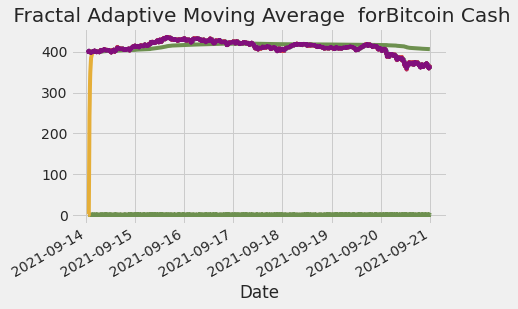

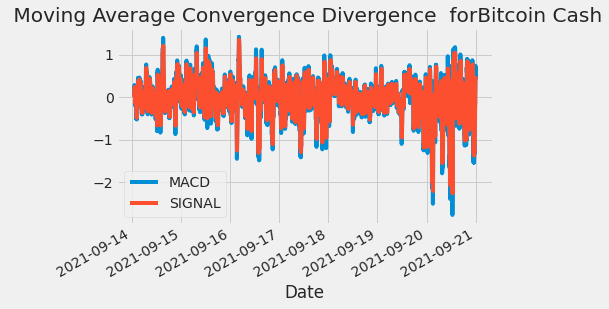

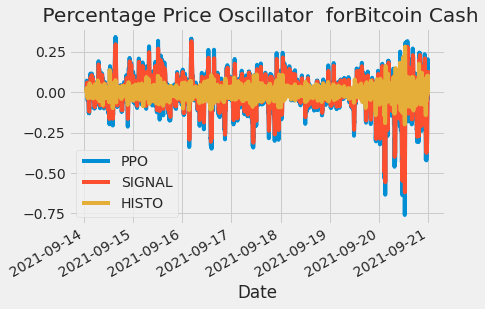

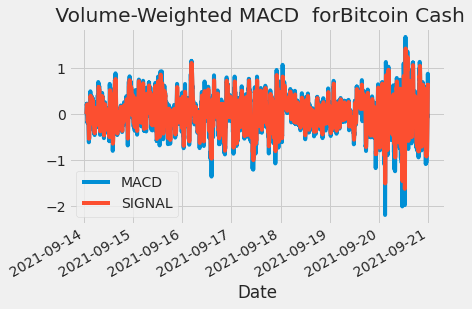

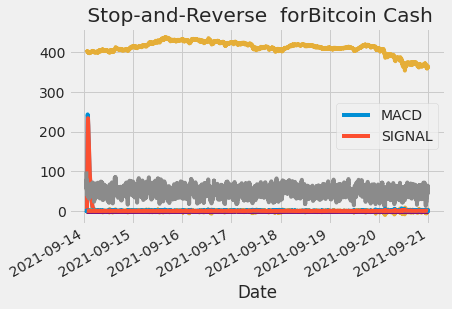

...

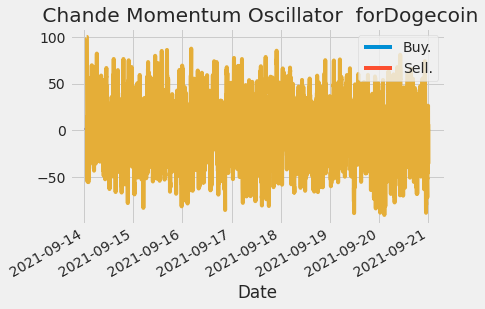

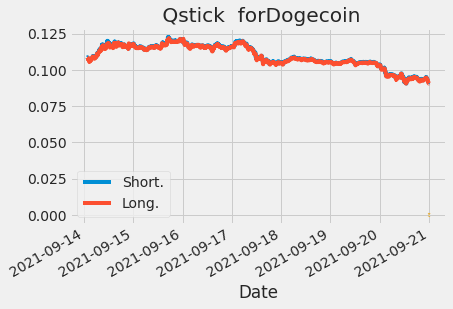

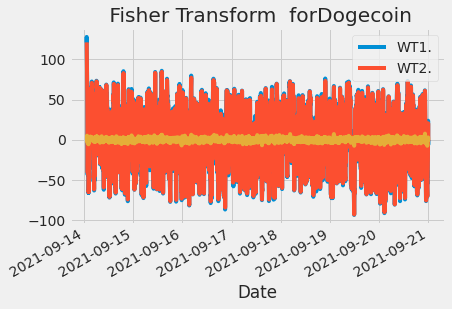

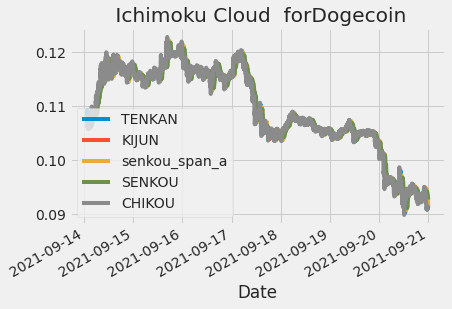

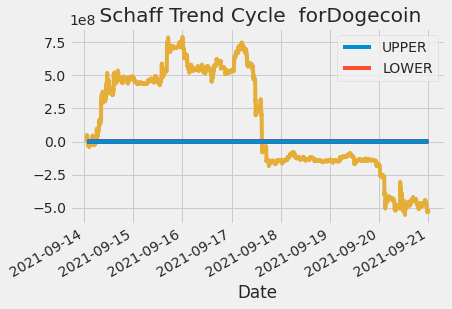

In [34]:
function_dict = {' Simple Moving Average ' : 'SMA',
                 ' Simple Moving Median ' : 'SMM',
                 ' Smoothed Simple Moving Average ' : 'SSMA',
                 ' Exponential Moving Average ' : 'EMA',
                 ' Double Exponential Moving Average ' : 'DEMA',
                 ' Triple Exponential Moving Average ' : 'TEMA',
                 ' Triangular Moving Average ' : 'TRIMA',
                 ' Triple Exponential Moving Average Oscillator ' : 'TRIX',
                 ' Volume Adjusted Moving Average ' : 'VAMA',
                 ' Kaufman Efficiency Indicator ' : 'ER',
                 ' Kaufmans Adaptive Moving Average ' : 'KAMA',
                 ' Zero Lag Exponential Moving Average ' : 'ZLEMA',
                 ' Weighted Moving Average ' : 'WMA',
                 ' Hull Moving Average ' : 'HMA',
                 ' Elastic Volume Moving Average ' : 'EVWMA',
                 ' Volume Weighted Average Price ' : 'VWAP',
                 ' Smoothed Moving Average ' : 'SMMA',
                 ' Fractal Adaptive Moving Average ' : 'FRAMA',
                 ' Moving Average Convergence Divergence ' : 'MACD',
                 ' Percentage Price Oscillator ' : 'PPO',
                 ' Volume-Weighted MACD ' : 'VW_MACD',
                 ' Elastic-Volume weighted MACD ' : 'EV_MACD',
                 ' Market Momentum ' : 'MOM',
                 ' Rate-of-Change ' : 'ROC',
                 ' Relative Strength Index ' : 'RSI',
                 ' Inverse Fisher Transform RSI ' : 'IFT_RSI',
                 ' True Range ' : 'TR',
                 ' Average True Range ' : 'ATR',
                 ' Stop-and-Reverse ' : 'SAR',
                 ' Bollinger Bands ' : 'BBANDS',
                 ' Bollinger Bands Width ' : 'BBWIDTH',
                 ' Momentum Breakout Bands ' : 'MOBO',
                 ' Percent B ' : 'PERCENT_B',
                 ' Keltner Channels ' : 'KC',
                 ' Donchian Channel ' : 'DO',
                 ' Directional Movement Indicator ' : 'DMI',
                 ' Average Directional Index ' : 'ADX',
                 ' Pivot Points ' : 'PIVOT',
                 ' Fibonacci Pivot Points ' : 'PIVOT_FIB',
                 ' Stochastic Oscillator Percent K ' : 'STOCH',
                 ' Stochastic oscillator Percent D ' : 'STOCHD',
                 ' Stochastic RSI ' : 'STOCHRSI',
                 ' Williams Percent R ' : 'WILLIAMS',
                 ' Ultimate Oscillator ' : 'UO',
                 ' Awesome Oscillator ' : 'AO',
                 ' Mass Index ' : 'MI',
                 ' Vortex Indicator ' : 'VORTEX',
                 ' Know Sure Thing ' : 'KST',
                 ' True Strength Index ' : 'TSI',
                 ' Typical Price ' : 'TP',
                 ' Accumulation-Distribution Line ' : 'ADL',
                 ' Chaikin Oscillator ' : 'CHAIKIN',
                 ' Money Flow Index ' : 'MFI',
                 ' On Balance Volume ' : 'OBV',
                 ' Weighter OBV ' : 'WOBV',
                 ' Volume Zone Oscillator ' : 'VZO',
                 ' Price Zone Oscillator ' : 'PZO',
                 ' Elders Force Index ' : 'EFI',
                 ' Cummulative Force Index ' : 'CFI',
                 ' Bull power and Bear Power ' : 'EBBP',
                 ' Ease of Movement ' : 'EMV',
                 ' Commodity Channel Index ' : 'CCI',
                 ' Coppock Curve ' : 'COPP',
                 ' Buy and Sell Pressure ' : 'BASP',
                 ' Normalized BASP ' : 'BASPN',
                 ' Chande Momentum Oscillator ' : 'CMO',
                 ' Chandelier Exit ' : 'CHANDELIER',
                 ' Qstick ' : 'QSTICK',
                 #' Twiggs Money Index ' : 'TMF',
                 ' Wave Trend Oscillator ' : 'WTO',
                 ' Fisher Transform ' : 'FISH',
                 ' Ichimoku Cloud ' : 'ICHIMOKU',
                 ' Adaptive Price Zone ' : 'APZ',
                 #' Squeeze Momentum Indicator ' : 'SQZMI',
                 ' Volume Price Trend ' : 'VPT',
                 ' Finite Volume Element ' : 'FVE',
                 ' Volume Flow Indicator ' : 'VFI',
                 ' Moving Standard deviation ' : 'MSD',
                 ' Schaff Trend Cycle ' : 'STC'}


for i in range(0,14):
    subsett = crypto_df_subset(i, crypto_df)
    subsett['Date'] = pd.to_datetime(subsett.Date, utc=False)
    subsett.index = pd.DatetimeIndex(subsett['Date'])
    ohlc=subsett[-10000:]
    for key, value in function_dict .items():
        function_name = "TA." + value + "(ohlc).plot(title='" + key + " for" + asset_names[i]+ "')"
        result = eval(function_name)

**BackTesting Trading Strategy (for Bit coin)**

In [35]:
# Defining DEMA cross strategy
class DemaCross(Strategy):

    def init(self):

        self.ma1 = self.I(TA.DEMA, ohlc, 10)
        self.ma2 = self.I(TA.DEMA, ohlc, 20)

    def next(self):
        if crossover(self.ma1, self.ma2):
            self.buy()
        elif crossover(self.ma2, self.ma1):
            self.sell()

Let us do a bit of backtesting with a value of $100000 (for Bit Coin)

In [36]:
ohlc = btc
bt = Backtest(ohlc, DemaCross,
              cash=100000, commission=0.015, exclusive_orders=True)

In [37]:
#Back Testing Summary (for Bit Coin)
bt.run()

Start                                     0.0
End                                    9999.0
Duration                               9999.0
Exposure Time [%]                       49.45
Equity Final [$]                     353.5889
Equity Peak [$]                      100000.0
Return [%]                         -99.646411
Buy & Hold Return [%]               -8.660214
Return (Ann.) [%]                         0.0
Volatility (Ann.) [%]                     NaN
Sharpe Ratio                              NaN
Sortino Ratio                             NaN
Calmar Ratio                              0.0
Max. Drawdown [%]                  -99.646432
Avg. Drawdown [%]                  -99.646432
Max. Drawdown Duration                 9997.0
Avg. Drawdown Duration                 9997.0
# Trades                                407.0
Win Rate [%]                           0.2457
Best Trade [%]                       0.254568
Worst Trade [%]                     -2.592871
Avg. Trade [%]                    

In [38]:
#Use Zoom to see the performance of the stock (for Bit Coin)
bt.plot()

Row(id='1413', ...)

**BackTesting Trading Strategy Using KNN (for Bit Coin)**

In [39]:
from backtesting import Strategy
from backtesting.lib import crossover
from backtesting.test import SMA
from backtesting.lib import plot_heatmaps

def BBANDS(data, n_lookback, n_std):
    """Bollinger bands indicator"""
    hlc3 = (data.High + data.Low + data.Close) / 3
    mean, std = hlc3.rolling(n_lookback).mean(), hlc3.rolling(n_lookback).std()
    upper = mean + n_std*std
    lower = mean - n_std*std
    return upper, lower



class Sma4Cross(Strategy):
    n1 = 50
    n2 = 100
    n_enter = 20
    n_exit = 10
    
    def init(self):
        self.sma1 = self.I(SMA, self.data.Close, self.n1)
        self.sma2 = self.I(SMA, self.data.Close, self.n2)
        self.sma_enter = self.I(SMA, self.data.Close, self.n_enter)
        self.sma_exit = self.I(SMA, self.data.Close, self.n_exit)
        
    def next(self):
        
        if not self.position:
            
            # On upwards trend, if price closes above
            # "entry" MA, go long
            
            # Here, even though the operands are arrays, this
            # works by implicitly comparing the two last values
            if self.sma1 > self.sma2:
                if crossover(self.data.Close, self.sma_enter):
                    self.buy()
                    
            # On downwards trend, if price closes below
            # "entry" MA, go short
            
            else:
                if crossover(self.sma_enter, self.data.Close):
                    self.sell()
        
        # But if we already hold a position and the price
        # closes back below (above) "exit" MA, close the position
        
        else:
            if (self.position.is_long and
                crossover(self.sma_exit, self.data.Close)
                or
                self.position.is_short and
                crossover(self.data.Close, self.sma_exit)):
                
                self.position.close()

**BackTesting Trading Strategy Heatmaps (for Bit Coin)**

In [40]:
%%time 

from backtesting import Backtest
from backtesting.test import GOOG
from backtesting.lib import plot_heatmaps


backtest = Backtest(ohlc, Sma4Cross, commission=.002)

stats, heatmap = backtest.optimize(
    n1=range(10, 110, 10),
    n2=range(20, 210, 20),
    n_enter=range(15, 35, 5),
    n_exit=range(10, 25, 5),
    constraint=lambda p: p.n_exit < p.n_enter < p.n1 < p.n2,
    maximize='Equity Final [$]',
    max_tries=200,
    random_state=0,
    return_heatmap=True)

Backtest.optimize:   0%|          | 0/3 [00:00<?, ?it/s]

CPU times: user 1.07 s, sys: 623 ms, total: 1.7 s
Wall time: 54.3 s


In [41]:
heatmap

n1   n2   n_enter  n_exit
20   60   15       10        3085.601959
     80   15       10        3105.608867
     100  15       10        3049.606741
30   40   20       15        3736.050813
          25       15        4501.445026
                                ...     
100  200  15       10        2886.457056
          20       10        3664.887342
                   15        3560.495640
          25       10        4143.207555
          30       10        4716.645737
Name: Equity Final [$], Length: 177, dtype: float64

In [42]:
hm = heatmap.groupby(['n1', 'n2']).mean().unstack()
hm

n2,40,60,80,100,120,140,160,180,200
n1,,,,,,,,,
20,NaN,3085.601959,3105.608867,3049.606741,NaN,NaN,NaN,NaN,NaN
30,4118.74792,3768.590901,3495.785959,4077.941478,3426.615729,3700.369252,3868.809493,3719.230314,3959.749659
40,NaN,3993.061287,NaN,4613.227596,3956.296241,3758.435337,3644.452114,3915.672228,3930.056935
50,NaN,4412.488835,4002.446431,4138.623655,4382.031629,3466.870044,3897.393484,4011.549570,3797.619102
60,NaN,NaN,4038.161934,4416.857980,3838.817313,3643.461503,4516.686665,4159.625283,4008.791990
70,NaN,NaN,3466.951512,4756.806154,3928.403999,4249.301684,4202.609306,3778.353995,4143.409598
80,NaN,NaN,NaN,3891.873776,4276.001184,4149.083987,4454.554938,4112.263194,4275.081774
90,NaN,NaN,NaN,4919.980032,4311.806844,3787.245467,4600.562312,3721.047736,4551.950827
100,NaN,NaN,NaN,NaN,4120.926140,4561.016230,4385.397963,4230.873024,3794.338666


In [43]:
from backtesting.lib import plot_heatmaps

plot_heatmaps(heatmap, agg='mean')

Column(id='1954', ...)

In [44]:
%%capture

!pip install scikit-optimize  # This is a run-time dependency

In [45]:
%%time

stats_skopt, heatmap, optimize_result = backtest.optimize(
    n1=[10, 100],      # Note: For method="skopt", we
    n2=[20, 200],      # only need interval end-points
    n_enter=[10, 40],
    n_exit=[10, 30],
    constraint=lambda p: p.n_exit < p.n_enter < p.n1 < p.n2,
    maximize='Equity Final [$]',
    method='skopt',
    max_tries=200,
    random_state=0,
    return_heatmap=True,
    return_optimization=True)

Backtest.optimize:   0%|          | 0/200 [00:00<?, ?it/s]

CPU times: user 54.3 s, sys: 721 ms, total: 55 s
Wall time: 1min 5s


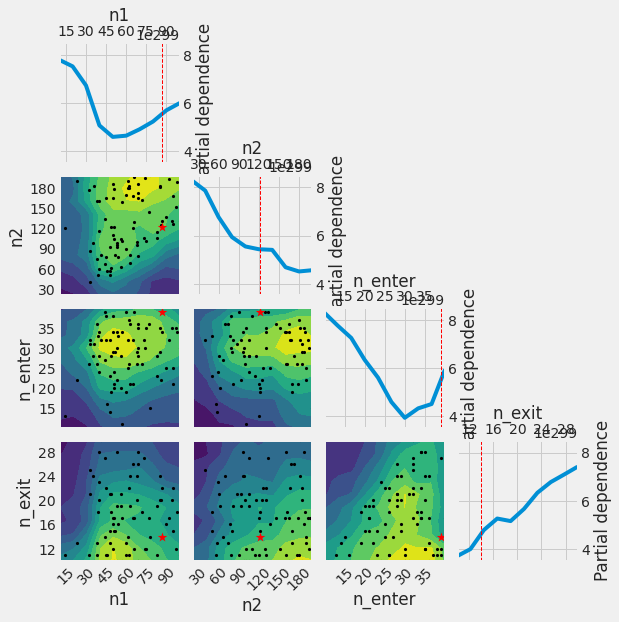

In [46]:
from skopt.plots import plot_objective

_ = plot_objective(optimize_result, n_points=10)

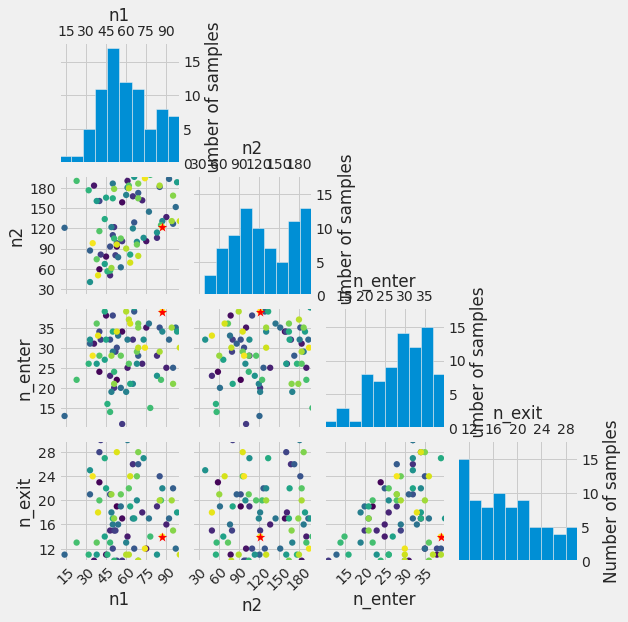

In [47]:
from skopt.plots import plot_evaluations

_ = plot_evaluations(optimize_result, bins=10)